# 4D Dubins Car

We consider the 4D dubins car problem, and consider the following dynamics


State: $$[x, y, v, \theta]$$

Dynamics:
$$\begin{bmatrix}\dot x \\ \dot y \\ \dot v\\ \dot \theta \end{bmatrix} = \begin{bmatrix}v \text{cos}(\theta) \\ v \text{sin}(\theta) \\ a \\ \omega\end{bmatrix}, \text{with } u=[a, \omega]$$


In [160]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [161]:
import sys; sys.version

'3.8.10 (default, Nov 22 2023, 10:22:35) \n[GCC 9.4.0]'

In [162]:
import matplotlib
matplotlib.rcParams.update({
    "pgf.texsystem": "pdflatex",
    'font.family': 'serif',
    'font.size': '20',
    'text.usetex': False,   # Toggle to true for official LaTeX output
    'pgf.rcfonts': False,
    'lines.linewidth': 4.,
})

In [163]:
import warnings
# warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")
from matplotlib import MatplotlibDeprecationWarning
warnings.filterwarnings("ignore", category=MatplotlibDeprecationWarning)
import matplotlib.pyplot as plt
import jax.numpy as jnp
import jax
import numpy as np
import seaborn as sns

import matplotlib
import pickle as pkl
import pandas as pd

from scipy.interpolate import interp1d
from matplotlib.animation import FuncAnimation
from mpl_toolkits.axes_grid1 import make_axes_locatable
from IPython.display import HTML
from dubins import nominal_hjr_control

In [164]:
import hj_reachability as hj
import cbf_opt
from cbf_opt import ControlAffineDynamics, ControlAffineCBF, ControlAffineASIF, SlackifiedControlAffineASIF, BatchedDynamics
from experiment_wrapper import RolloutTrajectory, StateSpaceExperiment, TimeSeriesExperiment

from refine_cbfs import HJControlAffineDynamics, TabularControlAffineCBF, TabularTVControlAffineCBF, utils

from dubins.animate_car import animate_multi_planar_car, get_car

## Setup Problem (dynamics, environment and CBF)

### Dynamics

In [165]:
class DubinsDynamics4D(ControlAffineDynamics):
    """
    Simplified dynamics, and we need to convert controls from phi to tan(phi)"""
    STATES = ["x", "y", "v", "theta"]
    CONTROLS = ["a", "w"]
    DISTURBANCES = []
    def __init__(self, params, **kwargs):
        super().__init__(params, **kwargs)
    
    def open_loop_dynamics(self, state, time: float = 0.0):
        return jnp.array([state[2]*jnp.cos(state[3]), state[2]*jnp.sin(state[3]), 0.0, 0.0])

    def control_matrix(self, state, time: float = 0.0):
        return jnp.array([[0.0, 0.0], [0.0, 0.0], [1.0, 0.0], [0.0, 1.0]])
    

In [166]:
dyn = DubinsDynamics4D(params={}, dt=0.1, test=False)
batched_dyn = BatchedDynamics(dyn)
umax = jnp.array([1.0, 0.5])
umin = jnp.array([-1.0, -0.5])

## Environment:
### Boundary of grid
Boundary of grid is defined below by the state domain
### Environment / obstacles
Safe set is delimited by the state space boundary and by obstacles

In [167]:
state_domain = hj.sets.Box(lo=jnp.array([-6., -0.1, -5., -5.]), 
                           hi=jnp.array([6., 4.1, 5., 5.]))
grid_resolution = (25, 25, 25, 25)  
grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(state_domain, grid_resolution)

In [168]:
boundary = np.array([[-5., 5.], [0., 4.], [-10., 10.], [-10., 10.]])
obstacle1 = np.array([[-2., 0.], [2., 3.], [-100., 100.], [-100., 100.]])
obstacle2 = np.array([[1., 3.], [0., 1.], [-100., 100.], [-100., 100.]])
obstacles = [obstacle1, obstacle2]

In [169]:
sdf = utils.build_sdf(boundary, obstacles[:1])
updated_sdf = utils.build_sdf(boundary, obstacles)

In [170]:
sdf_values = hj.utils.multivmap(sdf, jnp.arange(grid.ndim))(grid.states)
updated_sdf_values = hj.utils.multivmap(updated_sdf, jnp.arange(grid.ndim))(grid.states)

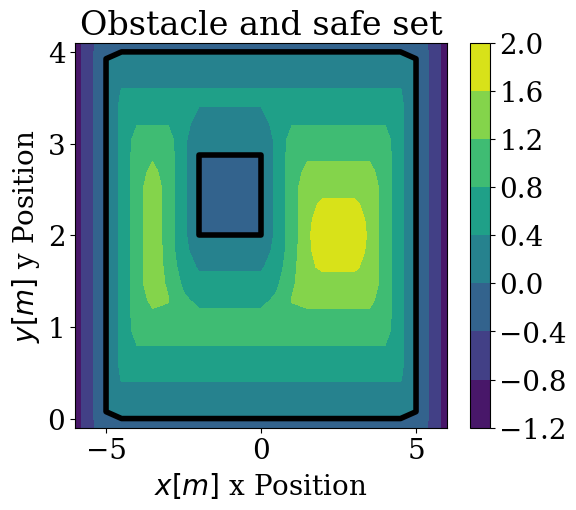

In [171]:
fig = plt.figure(figsize=(6, 5))
f = plt.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1], 
                 sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T)
plt.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
            sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='k')
plt.colorbar(f)
plt.xlabel("$x [m]$ x Position")
plt.ylabel("$y [m]$ y Position")
plt.title("Obstacle and safe set");

### Initial Control Barrier Function

In [172]:
class DubinsCBF(ControlAffineCBF):
    def __init__(self, dynamics, params, **kwargs):
        self.scaling = params["scaling"]
        self.center = params["center"]
        self.offset = params["offset"]
        self._vf_grad = jax.vmap(jax.grad(self.vf, argnums=0), in_axes=(0, None))
        super().__init__(dynamics, **kwargs)
    
    def vf(self, state, time=0.0):
        val = (self.offset - jnp.sum(self.scaling * (state - self.center) ** 2, axis=-1))
        return val
        # return jnp.where(val > 0, val, 0.1 * val)
    
    def _grad_vf(self, state, time=0.0):
        return self._vf_grad(state, time)

In [173]:
cbf_cf_params = {"scaling": jnp.array([2.0, 2.0, 1.0, 1.0]), "offset": 2.0, "center": jnp.array([-3.5, 2., 0.0, 0.])}
cbf_cf = DubinsCBF(batched_dyn, cbf_cf_params, test=False)

In [174]:
tabular_cbf = TabularControlAffineCBF(batched_dyn, params=cbf_cf_params, test=False, grid=grid)
tabular_cbf.tabularize_cbf(cbf_cf)

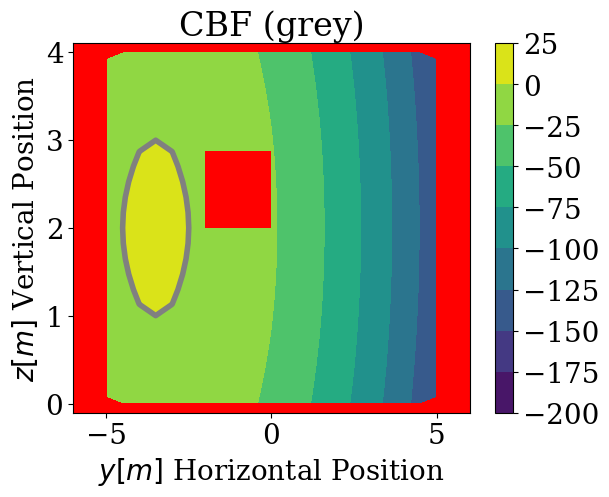

In [175]:
f = plt.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1], 
                 tabular_cbf.vf_table[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T)
plt.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
            tabular_cbf.vf_table[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='grey')
plt.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
            sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[-10, 0], colors='red')
plt.colorbar(f)
plt.xlabel("$y [m]$ Horizontal Position")
plt.ylabel("$z [m]$ Vertical Position")
plt.title("CBF (grey)");

# refineCBF: Refining a CBF with DP-based reachability

Below we consider a scenario in which we observe an obstacle 1/4 of the time in (hence after 1.25 s)

We still solve the original value function (with less obstacles) until completion for comparison.

We concatenate the original `target_values` with `target_values2` which use different solver settings (due to different obstacles)


Other possibilities for changes:
- Different dynamics (e.g. less control, add disturbance, etc.)

We also consider a minimum distance from the obstacle, which helps with visualization and can also provide robustness against failures

In [176]:
distance_from_obstacle = 0.2

In [177]:
dyn_hjr = HJControlAffineDynamics(dyn, control_space=hj.sets.Box(umin, umax))

backwards_reachable_tube = lambda obstacle: (lambda t, x: jnp.minimum(x, obstacle))
solver_settings = hj.SolverSettings.with_accuracy("high", value_postprocessor=backwards_reachable_tube(sdf_values - distance_from_obstacle))
solver_settings2 = hj.SolverSettings.with_accuracy("high", value_postprocessor=backwards_reachable_tube(updated_sdf_values - distance_from_obstacle))


In [178]:
init_values = tabular_cbf.vf_table
initial_time = 0.
final_time = -5.0
times = jnp.linspace(initial_time, final_time, 51)
target_values = hj.solve(solver_settings, dyn_hjr, grid, times, init_values)
target_values2 = hj.solve(solver_settings2, dyn_hjr, grid, times[len(times) // 4:], target_values[len(times) // 4])
target_values_full = jnp.concatenate([target_values[:len(times) // 4], target_values2])

100%|##########|  5.0000/5.0 [02:13<00:00, 26.63s/sim_s]
100%|##########|  3.8000/3.8000002 [01:27<00:00, 23.01s/sim_s]


In [179]:
sdf_full = jnp.concatenate([sdf_values[None].repeat(len(target_values) // 4, axis=0), updated_sdf_values[None].repeat(len(target_values2), axis=0)])

In [180]:
# Set up the figure and axis
fig = plt.figure()
ax = fig.add_subplot(111)

div = make_axes_locatable(ax)
cax = div.append_axes('right', '5%', '5%')

vmax = np.abs(target_values_full[0]).max()
cf = ax.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
                 target_values_full[0][:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, vmax=vmax, vmin=-vmax)
ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           tabular_cbf.vf_table[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='grey', linewidths=4)  
cont_sdf = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='k', linewidths=4)
cont = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           target_values_full[0][:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='green', linewidths=2)
cb = fig.colorbar(cf, cax=cax)
tx = ax.set_title(f'HJR time $t=0$')
ax.set_xlabel('$y$ (Horizontal)')
ax.set_ylabel('$z$ (Vertical)')
tx = ax.set_title(f'$v_y=0, v_z=0$, HJR time $t=0$')

# Update function to draw contours for a given idi value
def update(idi):
    global cont, cont_sdf
    arr = target_values_full[idi][:, :, grid.shape[2] // 2, grid.shape[3] // 2].T
    arr_sdf = sdf_full[idi][:, :, grid.shape[2] // 2, grid.shape[3] // 2].T
    vmax = np.abs(arr).max()
    # ax.clear()
    cf = ax.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1], arr, vmax=vmax, vmin=-vmax)
    cont.collections[0].remove()
    cont = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
               arr, levels=[0], colors='green')
    cont_sdf.collections[0].remove()
    cont_sdf = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
                          arr_sdf, levels=[0], colors='k', linewidths=4)
    cax.cla()
    fig.colorbar(cf, cax=cax)
    tx.set_text('HJR time t={:.2f}'.format(np.abs(times[idi].item())))


# Animate with idi values from 0 to 11
ani = FuncAnimation(fig, update, frames=range(len(times)))
plt.close()
HTML(ani.to_jshtml())

In [181]:
# Set up the figure and axis
fig = plt.figure()
ax = fig.add_subplot(111)


ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           tabular_cbf.vf_table[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='grey', linewidths=4)  
cont3 = ax.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[-10, 0], colors='red')
cont2 = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='k', linewidths=4)
cont = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           target_values_full[0][:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='green', linewidths=2)
ax.set_xlabel('$y$ (Horizontal)')
ax.set_ylabel('$z$ (Vertical)')
tx = ax.set_title(f'$v_y=0, v_z=0$, HJR time $t=0$')

# Update function to draw contours for a given idi value
def update(idi):
    global cont, cont2, cont3
    arr = target_values_full[idi][:, :, grid.shape[2] // 2, grid.shape[3] // 2].T
    arr_sdf = sdf_full[idi][:, :, grid.shape[2] // 2, grid.shape[3] // 2].T
    vmax = np.abs(arr).max()
    # ax.clear()
    cont.collections[0].remove()
    cont = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
               arr, levels=[0], colors='green')
    cont2.collections[0].remove()
    cont2 = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
                          arr_sdf, levels=[0], colors='k', linewidths=4)
    cont3.collections[0].remove()
    cont3 = ax.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           arr_sdf, levels=[-10, 0], colors='red')
    tx.set_text('$v_y=0, v_z=0$, HJR time t={:.2f}'.format(np.abs(times[idi].item())))


# Animate with idi values from 0 to 11
ani = FuncAnimation(fig, update, frames=range(len(times)));
plt.close()
HTML(ani.to_jshtml())

## Online implementation

### Comparisons
We compare the following algorithms:
- Nominal safety-agnostic control
- Heuristic CBF (what people use in practice!)
- CBVF computed using `refineCBF` from heuristic CBF offline
- Time varying CBVF (Ours)

### Value function evolution

The timescales over which we solved for the value function offline (see above) might not be real-time feasible. Hence we consider it is solved at a different frequency (e.g., artificially slowing down how the value function changes), to test out the framework.

Here we "slow" the reachability updates by a factor 4!

In [182]:
times_sim = jnp.linspace(0., 20., len(times))
sdf_values_f = interp1d(times_sim, sdf_full, axis=0)

In [183]:
tabular_finalized_cbf = TabularControlAffineCBF(batched_dyn, test=False, grid=grid)
tabular_finalized_cbf.vf_table = target_values[-1]

In [184]:
tv_cbf = TabularTVControlAffineCBF(batched_dyn, test=False, grid=grid)

In [185]:
tv_cbf.set_vf_table(times_sim, target_values_full)
target_values_f = tv_cbf.vf_table

  0%|          | 0/52 [00:00<?, ?it/s]

100%|██████████| 52/52 [00:26<00:00,  2.00it/s]


### Nominal control
We consider an LQR controller for nominal control. If you modify the experiment you can see that an LQR controller with safety filter is safe but can lead to us getting stuck

#### HJR Controller

This controller is best suited for a Dubins car but it performs very slowly in simulation due to the queueing of large tables

In [186]:
target = np.array([4.0, 1.0, 0.0, 0.0])

opt_ctrl = nominal_hjr_control.NominalControlHJNP(dyn_hjr, grid, final_time=-30, time_intervals=101, solver_accuracy="low", 
                                                  target=target, padding=jnp.array([.2, .2, jnp.pi / 6]))

opt_ctrl.solve()
np.save("dubins/performance_policy_vfs.npy", opt_ctrl.tv_vf)
    
nom_policy = nominal_hjr_control.NominalPolicy(opt_ctrl)

100%|##########| 30.0000/30.0 [02:45<00:00,  5.53s/sim_s]


#### Proportional Derivative Controller

This controller does not work as well for a Dubins car but the computation is significantly quicker

In [187]:
target = np.array([4.0, 1.0, 0.0, 0.0])

Kp = .1
Kd = -1
Kw = 2

nom_policy = lambda x, t: np.clip([[Kp*(np.linalg.norm(target[0:1]-x[0][0:2]))+Kd*x[0][2], Kw*(np.arctan2(target[1]-x[0][1],target[0]-x[0][0])-x[0][3])]], umin, umax)

### Safety filter
We use the slackified version of the safety filter to ensure , we use gurobi as a solver (you need to obtain an academic license, or change the solver to e.g. "ECOS" / "OSQP")

In [188]:
x_goal = jnp.array([4.0, 1.0, 0.0, 0.0])
u_goal = jnp.array([0.0, 0.0])
import cvxpy as cp
alpha = lambda x: 3.0 * x
tv_cbvf_asif = SlackifiedControlAffineASIF(batched_dyn, tv_cbf, test=False, alpha=alpha, nominal_policy=nom_policy,
                                           umin=umin, umax=umax, solver=cp.GUROBI)

cbvf_asif = SlackifiedControlAffineASIF(batched_dyn, tabular_finalized_cbf, test=False, alpha=alpha, nominal_policy=nom_policy,
                                        umin=umin, umax=umax, solver=cp.GUROBI)

cbf_asif = SlackifiedControlAffineASIF(batched_dyn, cbf_cf, test=False, alpha=alpha, nominal_policy=nom_policy,
                                       umin=umin, umax=umax, solver=cp.GUROBI)

In [189]:
x0 = jnp.array([-4.0, 2.0, 0.0, 0.0])
experiment = RolloutTrajectory('car', start_x=x0, n_sims_per_start=1, t_sim=20.0)

In [190]:
import logging
logging.getLogger('cbf_opt').setLevel(level=logging.ERROR)
results_df = experiment.run(batched_dyn, {"nominal": nom_policy, "CBF": cbf_asif, "CBVF": cbvf_asif, "TV_CBVF": tv_cbvf_asif})

Controller rollout:  10%|▉         | 19/200 [00:00<00:04, 41.61it/s]

Controller rollout: 100%|██████████| 200/200 [00:36<00:00,  5.53it/s]


In [191]:
# Find closest time in results_df.t to time_ind
def find_closest_time(df, time_ind):
    return df.t.iloc[df.t.sub(time_ind).abs().idxmin()]


ss_exp = StateSpaceExperiment('quad', x_indices=[0, 1], start_x=x0)
# Set up the figure and axis
fig = plt.figure(figsize=(20,10))
ax = fig.add_subplot(111)
alphas = [0.1, 0.5, 0.5, 1.0]
nbr_controllers = len(results_df.controller.unique())

plt.legend(results_df.controller.unique())
ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           tabular_cbf.vf_table[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='grey', linewidths=4)  
cont3 = ax.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[-10, 0], colors='red')
cont2 = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           sdf_values[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='k', linewidths=4)
cont = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
           target_values_f(0.0)[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T, levels=[0], colors='green', linewidths=2)
ax.set_xlabel('$x$ [m]', fontsize=20)
ax.set_ylabel('$y$ [m]', fontsize=20)
tx = ax.set_title('$v_y=0, v_z=0$, HJR time $t=0$')
ss_exp.plot(batched_dyn, results_df, ax=ax, add_direction=False, max_time=0.0, alpha=alphas)
ax.legend(ax.lines[::len(ax.lines) // nbr_controllers], results_df.controller.unique(), loc="upper center", ncol=4, fontsize=20)

# Update function to draw contours for a given idi value
def update(time):
    global cont, cont2, cont3
    arr = target_values_f(time)[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T
    sdf_arr = sdf_values_f(time)[:, :, grid.shape[2] // 2, grid.shape[3] // 2].T
    # ax.clear()
    for line in ax.lines:
        line.remove()
    for patch in ax.patches:
        patch.remove()
    ax.set_prop_cycle(None)
    cont.collections[0].remove()
    cont = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
               arr, levels=[0], colors='green')
    cont2.collections[0].remove()
    cont2 = ax.contour(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
                            sdf_arr, levels=[0], colors='k', linewidths=4)
    cont3.collections[0].remove()
    cont3 = ax.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1],
                        sdf_arr, levels=[-10, 0], colors='red')
    ss_exp.plot(batched_dyn, results_df, ax=ax, add_direction=False, max_time=time, alpha=alphas)
    closest_time = find_closest_time(results_df, time)
    curr_vals = results_df[(results_df.t == closest_time) & (results_df.measurement.isin(["x", "y", "theta"]))].value.values.reshape(nbr_controllers, -1)
    colors = []
    for line in ax.lines[::len(ax.lines) // nbr_controllers]:
        colors.append(line.get_color())
    for i, curr_val in enumerate(curr_vals):
        # get color from prop_cycle 
        get_car(ax, curr_val[0], curr_val[1], curr_val[2], rel_size=0.15, alpha=alphas[i], color=colors[i])
    tx.set_text('$v=0, theta=0$, Simulation time t={:.2f}'.format(np.abs(time)))
    fig.tight_layout()

ani = FuncAnimation(fig, update, frames=np.linspace(0,20,100))
plt.close()
HTML(ani.to_jshtml())